# 左から右に行くモデル

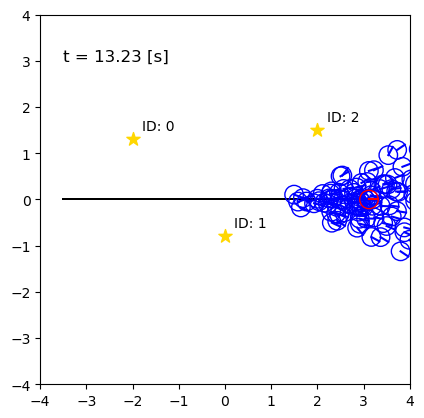

In [1]:
import matplotlib as mpl 
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import math
from collections import namedtuple

mpl.rcParams['animation.embed_limit'] = 50 
 
particle_num = 100  # パーティクルの数  
frame_num = 400  # フレーム数  
dt = 0.033  # 1ステップの時間33ms  .
x0 = [-3.5, 0.0, 0.0]  # 初期値  
r = [0.2 for _ in range(particle_num)]  # 円の半径  
r_std=0.2
weight = [1/(particle_num) for _ in range(particle_num)]
save_x = []
save_y = []

sigma_l=0.14 
sigma_fai=0.05 

# ランドマークの座標  
m = np.array([  
    [-2, 1.3],  
    [0, -0.8],  
    [2, 1.5]  
])   
Q=[[np.array([
    [0 , 0],
    [0 , sigma_fai**2]])for _ in range(particle_num)] for _ in range(len(m))]
z=[[np.array([
    [0],
    [0]])for _ in range(particle_num)] for _ in range(len(m))]
h=[np.array([
    [0],
    [0]])for _ in range(len(m))]

# 観測ベクトル  
l = np.array([[0.0 for _ in range(len(m))] for _ in range(particle_num)])  
fai = np.array([[0.0 for _ in range(len(m))] for _ in range(particle_num)])  

l_std = np.array([0.0 for _ in range(len(m))])  
fai_std = np.array([0.0 for _ in range(len(m))])

# 初期化  
time = 0  # 初期時間  
machin_x = np.array([x0 for _ in range(particle_num)])  # 姿勢ベクトル 
machin_x_std = x0  # 姿勢ベクトル
u0 = [0.5, 0.0]  
u = np.array([u0 for _ in range(particle_num)])  # 制御指令  
u_std = u0

ramda = 5  
  
# 確率関数  
def sisuu_bunp(ramda, sikiiti):  
    value = np.random.exponential(scale=1/ramda)  
    return value <= sikiiti  
  
def gausu_bunp(heikin, hyoujuuhensa):  
    return np.random.normal(loc=heikin, scale=hyoujuuhensa)  

def tazigen_gausu_bunp(z, myu, sigma):
    tenti = (z - myu)
    try:
        exponent = -0.5 * tenti.T @ np.linalg.inv(sigma) @ tenti
        exponent_scalar = exponent.item() if exponent.size == 1 else exponent[0, 0]
        return -1 / math.sqrt((2 * np.pi) ** len(myu) * np.linalg.det(sigma)) * math.exp(exponent_scalar)
    except Exception as e:
        return 0

def keitou_sampling(N,W):
    ruiseki = np.cumsum(W)
    positions = (np.arange(N) + np.random.uniform(0, 1)) / N  # 等間隔なサンプリング位置
    indices = np.zeros(N, dtype=np.int32)  # 結果の配列
    # 系統サンプリング
    i, j = 0, 0
    while i < N:
        if positions[i] < ruiseki[j]:
            indices[i] = j
            i += 1
        else:
            j += 1
    return indices

# ランドマークの描画  
rand_mark_positions = [(m[i, 0], m[i, 1], f"ID: {i}") for i in range(len(m))]  
 
#スタックの設定 
stack_time=[np.random.exponential(scale=1/5) for _ in range(particle_num)] 
stacking_time=[np.random.exponential(scale=1/5) for _ in range(particle_num)] 
stack_flag=[0 for _ in range(particle_num)] 
stack_count=[0 for _ in range(particle_num)] 
 
# グラフの設定  
fig, ax = plt.subplots()  
ax.set_xlim(-4, 4)  # x軸の範囲  
ax.set_ylim(-4, 4)  # y軸の範囲  
ax.set_aspect('equal')  # アスペクト比を1:1に設定  
  
# 円の描画  
circle_std = plt.Circle((0, 0), r_std, facecolor="none", edgecolor="red", zorder=10) 
for i in range(particle_num): 
    circles = [plt.Circle((0, 0), r[i], facecolor="none", edgecolor="blue", zorder=5) for _ in range(particle_num)]  
 
 
ax.add_artist(circle_std) 
for circle in circles:  
    ax.add_artist(circle)  
  
# ランドマークのプロット  
for x, y, rand_mark_id in rand_mark_positions:  
    ax.scatter(x, y, color="gold", s=100, marker="*", label="star")  
    ax.text(x + 0.2, y + 0.2, rand_mark_id, color="black", fontsize=10)  
  
# 直線の設定  
lines_std, = ax.plot([], [], color="red", zorder=10) 
lines = [ax.plot([], [], color="blue", zorder=5)[0] for _ in range(particle_num)]  
# ランドマーク直線  
rand_id = [ax.plot([], [], color="pink", zorder=10)[0] for _ in range(len(m))]
 
 
# 時間の表示  
time_text = ax.text(-3.5, 3, "", fontsize=12, color="black")  
  
# バイアス  
bias = np.array([[gausu_bunp(0, 0.5), gausu_bunp(0, 0.5)]for _ in range(particle_num)]) 
 
# 軌跡の初期化 
tracks = ax.plot([], [], color='black', linewidth=0.5, zorder=10)


# 更新関数 
def update(frame): 
    global time 
    global machin_x 
    global weight
    
     #ランドマーク
    for i in range(len(m)):
        l_std[i]=math.sqrt((m[i,0]-machin_x_std[0])**2+(m[i,1]-machin_x_std[1])**2)
        fai_std[i]=math.atan2(m[i,1]-machin_x_std[1],m[i,0]-machin_x_std[0])-machin_x_std[2]
        fai_std[i] = (fai_std[i] + math.pi) % (2 * math.pi) - math.pi
        if sisuu_bunp(2, 0.1):
            l_std[i]+=gausu_bunp(0,l_std[i])
            fai_std[i]+=gausu_bunp(0,np.pi/60)
        if l_std[i]< 2 and fai_std[i]> -math.pi/3 and fai_std[i]< math.pi/3:
            rand_end=[machin_x_std[0]+l_std[i]*np.cos(fai_std[i]+machin_x_std[2]),machin_x_std[1]+l_std[i]*np.sin(fai_std[i]+machin_x_std[2])]
            rand_id[i].set_data([machin_x_std[0], rand_end[0]], [machin_x_std[1], rand_end[1]])
            h[i]=np.array([
                            [l_std[i]],
                            [fai_std[i]]
                            ])
        else:
            rand_id[i].set_data([], [])
            h[i]=np.array([
                            0,
                            0
                            ])
    #円の更新
    circle_std.set_center((machin_x_std[0], machin_x_std[1]))
    save_x.append(machin_x_std[0])
    save_y.append(machin_x_std[1])
    # 直線の終点を計算
    end_x = machin_x_std[0] + r_std * np.cos(machin_x_std[2])
    end_y = machin_x_std[1] + r_std * np.sin(machin_x_std[2])

    
    # 直線を更新
    lines_std.set_data([machin_x_std[0], end_x], [machin_x_std[1], end_y])
    
    # 軌跡を描画
    ax.plot(save_x, save_y, color='black',linewidth=0.1)
    
    #時間の表示の更新
    time_text.set_text(f"t = {time:.2f} [s]")
    
    #座標の更新
    if u_std[1]!=0:
        machin_x_std[0]= machin_x_std[0] + (u_std[0]/u_std[1]) * (np.sin(machin_x_std[2]+u_std[1]*dt)-np.sin(machin_x_std[2]))
        machin_x_std[1]= machin_x_std[1] + (u_std[0]/u_std[1]) * (-1*np.cos(machin_x_std[2]+u_std[1]*dt)+np.cos(machin_x_std[2]))
        machin_x_std[2]+=u_std[1]*dt        
    else:
        machin_x_std[0]+= u_std[0] * np.cos(machin_x_std[2]) *dt
        machin_x_std[1]+= u_std[0] * np.sin(machin_x_std[2]) *dt
        machin_x_std[2]+=u_std[1]*dt
    
    
    for j in range(particle_num): 
        heikin=0
        count=0
        # ランドマーク 
        for i in range(len(m)): 
            l[j, i] = math.sqrt((m[i, 0] - machin_x[j, 0])**2 + (m[i, 1] - machin_x[j, 1])**2) 
            fai[j, i] = math.atan2(m[i, 1] - machin_x[j, 1], m[i, 0] - machin_x[j, 0]) - machin_x[j, 2]
            fai[j, i] = (fai[j, i] + math.pi) % (2 * math.pi) - math.pi
            if sisuu_bunp(2, 0.1): 
                l[j, i] += gausu_bunp(0, l[j, i]) 
                fai[j, i] += gausu_bunp(0, np.pi / 60)
            if l[j, i] < 2 and -math.pi/3 < fai[j, i] < math.pi/3:
                Q[i][j]=np.array([
                                [(l[j,i]*sigma_l)**2 , 0],
                                [0 , sigma_fai**2]])
                z[i][j]=np.array([
                                [l[j,i]],
                                [fai[j,i]]
                                ])
            else:
                Q[i][j]=np.array([
                                [1 , 0],
                                [0 , 1]])
                z[i][j]=np.array([
                                0,
                                0
                                ])
            heikin+=-1*tazigen_gausu_bunp(z[i][j],h[i],Q[i][j])
            count+=1

        if count>0:
            weight[j]=heikin/count
        #r=weight
        # 円の更新 
        circles[j].set_center((machin_x[j, 0], machin_x[j, 1])) 
         
        # 直線の終点を計算 
        end_x = machin_x[j, 0] + r[j] * np.cos(machin_x[j, 2]) 
        end_y = machin_x[j, 1] + r[j] * np.sin(machin_x[j, 2]) 
        lines[j].set_data([machin_x[j, 0], end_x], [machin_x[j, 1], end_y]) 
 
        # 小石を踏む反映 
        if sisuu_bunp(ramda, 0.1): 
            machin_x[j, 2] += gausu_bunp(0, np.pi / 60) 
        #スタックの判定 
        if abs(stack_time[j]-time)<0.1: 
           stack_flag[j]=1 
        if (stack_count[j]-stacking_time[j])<0.1: 
            stack_flag[j]=0 
            stack_time[j]=time+np.random.exponential(scale=1/5) 
             
        # 座標の更新 
        if stack_flag[j]==0: 
            if u[j, 1] != 0: 
                machin_x[j, 0] += ((u[j, 0] + bias[j, 0]) / (u[j, 1] + bias[j, 1])) * (np.sin(machin_x[j, 2] + (u[j, 1] + bias[j, 1]) * dt) - np.sin(machin_x[j, 2])) 
                machin_x[j, 1] += ((u[j, 0] + bias[j, 0]) / (u[j, 1] + bias[j, 1])) * (-np.cos(machin_x[j, 2] + (u[j, 1] + bias[j, 1]) * dt) + np.cos(machin_x[j, 2])) 
                machin_x[j, 2] += u[j, 1] * dt 
            else: 
                machin_x[j, 0] += (u[j, 0] + bias[j, 0]) * np.cos(machin_x[j, 2]) * dt 
                machin_x[j, 1] += (u[j, 0] + bias[j, 0]) * np.sin(machin_x[j, 2]) * dt 
        else: 
            stack_count[j]+=1
     #重さの正規化
    weight= weight/np.sum(weight)
    
    #系統サンプリング
    indices = keitou_sampling(particle_num,weight)
    machin_x = machin_x[indices]
    weight = np.ones_like(weight) / len(weight)
    

    # 時間の更新 
    time_text.set_text(f"t = {time:.2f} [s]") 
    time += dt     
    
    
    return circles + lines + tracks 
 
# アニメーションの作成 
ani = FuncAnimation(fig, update, frames=frame_num, interval=50, blit=False) 
 
# アニメーションを表示 
HTML(ani.to_jshtml()) 

# 右に行った後に旋回して左に戻るモデル

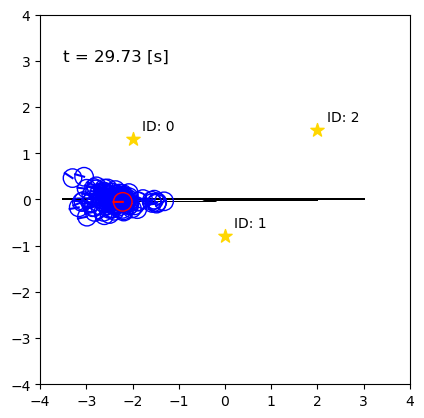

In [2]:
import matplotlib as mpl 
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import math
from collections import namedtuple

mpl.rcParams['animation.embed_limit'] = 50 
 
particle_num = 100  # パーティクルの数  
frame_num = 900  # フレーム数  
dt = 0.033  # 1ステップの時間33ms  .
x0 = [-3.5, 0.0, 0.0]  # 初期値  
r = [0.2 for _ in range(particle_num)]  # 円の半径  
r_std=0.2
weight = [1/(particle_num) for _ in range(particle_num)]
save_x = []
save_y = []

sigma_l=0.14 
sigma_fai=0.05 

# ランドマークの座標  
m = np.array([  
    [-2, 1.3],  
    [0, -0.8],  
    [2, 1.5]  
])   
Q=[[np.array([
    [0 , 0],
    [0 , sigma_fai**2]])for _ in range(particle_num)] for _ in range(len(m))]
z=[[np.array([
    [0],
    [0]])for _ in range(particle_num)] for _ in range(len(m))]
h=[np.array([
    [0],
    [0]])for _ in range(len(m))]

# 観測ベクトル  
l = np.array([[0.0 for _ in range(len(m))] for _ in range(particle_num)])  
fai = np.array([[0.0 for _ in range(len(m))] for _ in range(particle_num)])  

l_std = np.array([0.0 for _ in range(len(m))])  
fai_std = np.array([0.0 for _ in range(len(m))])

# 初期化  
time = 0  # 初期時間  
machin_x = np.array([x0 for _ in range(particle_num)])  # 姿勢ベクトル 
machin_x_std = x0  # 姿勢ベクトル
u0 = [0.5, 0.0]  
u = np.array([u0 for _ in range(particle_num)])  # 制御指令  
u_std = u0

ramda = 5  
  
# 確率関数  
def sisuu_bunp(ramda, sikiiti):  
    value = np.random.exponential(scale=1/ramda)  
    return value <= sikiiti  
  
def gausu_bunp(heikin, hyoujuuhensa):  
    return np.random.normal(loc=heikin, scale=hyoujuuhensa)  

def tazigen_gausu_bunp(z, myu, sigma):
    tenti = (z - myu)
    try:
        exponent = -0.5 * tenti.T @ np.linalg.inv(sigma) @ tenti
        exponent_scalar = exponent.item() if exponent.size == 1 else exponent[0, 0]
        return -1 / math.sqrt((2 * np.pi) ** len(myu) * np.linalg.det(sigma)) * math.exp(exponent_scalar)
    except Exception as e:
        return 0

def keitou_sampling(N,W):
    ruiseki = np.cumsum(W)
    positions = (np.arange(N) + np.random.uniform(0, 1)) / N  # 等間隔なサンプリング位置
    indices = np.zeros(N, dtype=np.int32)  # 結果の配列
    # 系統サンプリング
    i, j = 0, 0
    while i < N:
        if positions[i] < ruiseki[j]:
            indices[i] = j
            i += 1
        else:
            j += 1
    return indices

# ランドマークの描画  
rand_mark_positions = [(m[i, 0], m[i, 1], f"ID: {i}") for i in range(len(m))]  
 
#スタックの設定 
stack_time=[np.random.exponential(scale=1/5) for _ in range(particle_num)] 
stacking_time=[np.random.exponential(scale=1/5) for _ in range(particle_num)] 
stack_flag=[0 for _ in range(particle_num)] 
stack_count=[0 for _ in range(particle_num)] 
 
# グラフの設定  
fig, ax = plt.subplots()  
ax.set_xlim(-4, 4)  # x軸の範囲  
ax.set_ylim(-4, 4)  # y軸の範囲  
ax.set_aspect('equal')  # アスペクト比を1:1に設定  
  
# 円の描画  
circle_std = plt.Circle((0, 0), r_std, facecolor="none", edgecolor="red", zorder=10) 
for i in range(particle_num): 
    circles = [plt.Circle((0, 0), r[i], facecolor="none", edgecolor="blue", zorder=5) for _ in range(particle_num)]  
 
 
ax.add_artist(circle_std) 
for circle in circles:  
    ax.add_artist(circle)  
  
# ランドマークのプロット  
for x, y, rand_mark_id in rand_mark_positions:  
    ax.scatter(x, y, color="gold", s=100, marker="*", label="star")  
    ax.text(x + 0.2, y + 0.2, rand_mark_id, color="black", fontsize=10)  
  
# 直線の設定  
lines_std, = ax.plot([], [], color="red", zorder=10) 
lines = [ax.plot([], [], color="blue", zorder=5)[0] for _ in range(particle_num)]  
# ランドマーク直線  
rand_id = [ax.plot([], [], color="pink", zorder=10)[0] for _ in range(len(m))]
 
 
# 時間の表示  
time_text = ax.text(-3.5, 3, "", fontsize=12, color="black")  
  
# バイアス  
bias = np.array([[gausu_bunp(0, 0.5), gausu_bunp(0, 0.5)]for _ in range(particle_num)]) 
 
# 軌跡の初期化 
tracks = ax.plot([], [], color='black', linewidth=0.5, zorder=10)


# 更新関数 
def update(frame): 
    global time 
    global machin_x 
    global weight
    time_text.set_text(f"t = {time:.2f} [s]") 
     #ランドマーク
    
    for i in range(len(m)):
        l_std[i]=math.sqrt((m[i,0]-machin_x_std[0])**2+(m[i,1]-machin_x_std[1])**2)
        fai_std[i]=math.atan2(m[i,1]-machin_x_std[1],m[i,0]-machin_x_std[0])-machin_x_std[2]
        fai_std[i] = (fai_std[i] + math.pi) % (2 * math.pi) - math.pi
        if sisuu_bunp(2, 0.1):
            l_std[i]+=gausu_bunp(0,l_std[i])
            fai_std[i]+=gausu_bunp(0,np.pi/60)
        if l_std[i]< 2 and fai_std[i]> -math.pi/3 and fai_std[i]< math.pi/3:
            rand_end=[machin_x_std[0]+l_std[i]*np.cos(fai_std[i]+machin_x_std[2]),machin_x_std[1]+l_std[i]*np.sin(fai_std[i]+machin_x_std[2])]
            rand_id[i].set_data([machin_x_std[0], rand_end[0]], [machin_x_std[1], rand_end[1]])
            h[i]=np.array([
                            [l_std[i]],
                            [fai_std[i]]
                            ])
        else:
            rand_id[i].set_data([], [])
            h[i]=np.array([
                            0,
                            0
                            ])
    #円の更新
    circle_std.set_center((machin_x_std[0], machin_x_std[1]))
    save_x.append(machin_x_std[0])
    save_y.append(machin_x_std[1])
    # 直線の終点を計算
    end_x = machin_x_std[0] + r_std * np.cos(machin_x_std[2])
    end_y = machin_x_std[1] + r_std * np.sin(machin_x_std[2])

    
    # 直線を更新
    lines_std.set_data([machin_x_std[0], end_x], [machin_x_std[1], end_y])
    
    # 軌跡を描画
    ax.plot(save_x, save_y, color='black',linewidth=0.1)
    
    #時間の表示の更新
    time_text.set_text(f"t = {time:.2f} [s]")
    
    #座標の更新
    if u_std[1]!=0:
        machin_x_std[0]= machin_x_std[0] + (u_std[0]/u_std[1]) * (np.sin(machin_x_std[2]+u_std[1]*dt)-np.sin(machin_x_std[2]))
        machin_x_std[1]= machin_x_std[1] + (u_std[0]/u_std[1]) * (-1*np.cos(machin_x_std[2]+u_std[1]*dt)+np.cos(machin_x_std[2]))
        machin_x_std[2]+=u_std[1]*dt        
    else:
        machin_x_std[0]+= u_std[0] * np.cos(machin_x_std[2]) *dt
        machin_x_std[1]+= u_std[0] * np.sin(machin_x_std[2]) *dt
        machin_x_std[2]+=u_std[1]*dt
    
    
    for j in range(particle_num): 
        heikin=0
        count=0
        # ランドマーク 
        for i in range(len(m)): 
            l[j, i] = math.sqrt((m[i, 0] - machin_x[j, 0])**2 + (m[i, 1] - machin_x[j, 1])**2) 
            fai[j, i] = math.atan2(m[i, 1] - machin_x[j, 1], m[i, 0] - machin_x[j, 0]) - machin_x[j, 2]
            fai[j, i] = (fai[j, i] + math.pi) % (2 * math.pi) - math.pi
            if sisuu_bunp(2, 0.1): 
                l[j, i] += gausu_bunp(0, l[j, i]) 
                fai[j, i] += gausu_bunp(0, np.pi / 60)
            if l[j, i] < 2 and -math.pi/3 < fai[j, i] < math.pi/3:
                Q[i][j]=np.array([
                                [(l[j,i]*sigma_l)**2 , 0],
                                [0 , sigma_fai**2]])
                z[i][j]=np.array([
                                [l[j,i]],
                                [fai[j,i]]
                                ])
            else:
                Q[i][j]=np.array([
                                [1 , 0],
                                [0 , 1]])
                z[i][j]=np.array([
                                0,
                                0
                                ])
            heikin+=-1*tazigen_gausu_bunp(z[i][j],h[i],Q[i][j])
            count+=1

        if count>0:
            weight[j]=heikin/count
        #r=weight
        # 円の更新 
        circles[j].set_center((machin_x[j, 0], machin_x[j, 1])) 
         
        # 直線の終点を計算 
        end_x = machin_x[j, 0] + r[j] * np.cos(machin_x[j, 2]) 
        end_y = machin_x[j, 1] + r[j] * np.sin(machin_x[j, 2]) 
        lines[j].set_data([machin_x[j, 0], end_x], [machin_x[j, 1], end_y]) 
 
        # 小石を踏む反映 
        if sisuu_bunp(ramda, 0.1): 
            machin_x[j, 2] += gausu_bunp(0, np.pi / 60) 
        #スタックの判定 
        if abs(stack_time[j]-time)<0.1: 
           stack_flag[j]=1 
        if (stack_count[j]-stacking_time[j])<0.1: 
            stack_flag[j]=0 
            stack_time[j]=time+np.random.exponential(scale=1/5) 
             
        # 座標の更新 
        if stack_flag[j]==0: 
            if u[j, 1] != 0: 
                machin_x[j, 0] += ((u[j, 0] + bias[j, 0]) / (u[j, 1] + bias[j, 1])) * (np.sin(machin_x[j, 2] + (u[j, 1] + bias[j, 1]) * dt) - np.sin(machin_x[j, 2])) 
                machin_x[j, 1] += ((u[j, 0] + bias[j, 0]) / (u[j, 1] + bias[j, 1])) * (-np.cos(machin_x[j, 2] + (u[j, 1] + bias[j, 1]) * dt) + np.cos(machin_x[j, 2])) 
                machin_x[j, 2] += u[j, 1] * dt 
            else: 
                machin_x[j, 0] += (u[j, 0] + bias[j, 0]) * np.cos(machin_x[j, 2]) * dt 
                machin_x[j, 1] += (u[j, 0] + bias[j, 0]) * np.sin(machin_x[j, 2]) * dt 
        else: 
            stack_count[j]+=1
        if machin_x_std[0] > 3 and machin_x_std[2] < math.pi:
            u_std[0]=0
            u_std[1]=0.5
            u[j,0]=0
            u[j,1]=0.5
        else:
            u_std[0]=0.5
            u_std[1]=0
            u[j,0]=0.5
            u[j,1]=0
    #重さの正規化
    weight= weight/np.sum(weight)
    
    #系統サンプリング
    indices = keitou_sampling(particle_num,weight)
    machin_x = machin_x[indices]
    weight = np.ones_like(weight) / len(weight)
    

    # 時間の更新 
    
    time += dt     
    
    
    return circles + lines + tracks 
 
# アニメーションの作成 
ani = FuncAnimation(fig, update, frames=frame_num, interval=50, blit=False) 
 
# アニメーションを表示 
HTML(ani.to_jshtml()) 

# １次元的表現

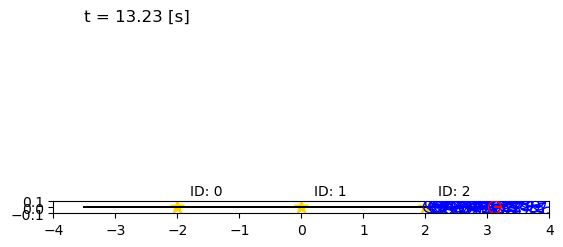

In [5]:
import matplotlib as mpl 
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import math
from collections import namedtuple

mpl.rcParams['animation.embed_limit'] = 50 
 
particle_num = 100  # パーティクルの数  
frame_num = 400  # フレーム数  
dt = 0.033  # 1ステップの時間33ms  .
x0 = [-3.5, 0.0, 0.0]  # 初期値  
r = [0.1 for _ in range(particle_num)]  # 円の半径  
r_std=0.1
weight = [1/(particle_num) for _ in range(particle_num)]
save_x = []
save_y = []

sigma_l=0.14 
sigma_fai=0.05 

# ランドマークの座標  
m = np.array([  
    [-2, 0],  
    [0, 0],  
    [2, 0]  
])   
Q=[[np.array([
    [0 , 0],
    [0 , sigma_fai**2]])for _ in range(particle_num)] for _ in range(len(m))]
z=[[np.array([
    [0],
    [0]])for _ in range(particle_num)] for _ in range(len(m))]
h=[np.array([
    [0],
    [0]])for _ in range(len(m))]

# 観測ベクトル  
l = np.array([[0.0 for _ in range(len(m))] for _ in range(particle_num)])  
fai = np.array([[0.0 for _ in range(len(m))] for _ in range(particle_num)])  

l_std = np.array([0.0 for _ in range(len(m))])  
fai_std = np.array([0.0 for _ in range(len(m))])

# 初期化  
time = 0  # 初期時間  
machin_x = np.array([x0 for _ in range(particle_num)])  # 姿勢ベクトル 
machin_x_std = x0  # 姿勢ベクトル
u0 = [0.5, 0.0]  
u = np.array([u0 for _ in range(particle_num)])  # 制御指令  
u_std = u0

ramda = 5  
  
# 確率関数  
def sisuu_bunp(ramda, sikiiti):  
    value = np.random.exponential(scale=1/ramda)  
    return value <= sikiiti  
  
def gausu_bunp(heikin, hyoujuuhensa):  
    return np.random.normal(loc=heikin, scale=hyoujuuhensa)  

def tazigen_gausu_bunp(z, myu, sigma):
    tenti = (z - myu)
    try:
        exponent = -0.5 * tenti.T @ np.linalg.inv(sigma) @ tenti
        exponent_scalar = exponent.item() if exponent.size == 1 else exponent[0, 0]
        return -1 / math.sqrt((2 * np.pi) ** len(myu) * np.linalg.det(sigma)) * math.exp(exponent_scalar)
    except Exception as e:
        return 0

def keitou_sampling(N,W):
    ruiseki = np.cumsum(W)
    positions = (np.arange(N) + np.random.uniform(0, 1)) / N  # 等間隔なサンプリング位置
    indices = np.zeros(N, dtype=np.int32)  # 結果の配列
    # 系統サンプリング
    i, j = 0, 0
    while i < N:
        if positions[i] < ruiseki[j]:
            indices[i] = j
            i += 1
        else:
            j += 1
    return indices

# ランドマークの描画  
rand_mark_positions = [(m[i, 0], m[i, 1], f"ID: {i}") for i in range(len(m))]  
 
#スタックの設定 
stack_time=[np.random.exponential(scale=1/5) for _ in range(particle_num)] 
stacking_time=[np.random.exponential(scale=1/5) for _ in range(particle_num)] 
stack_flag=[0 for _ in range(particle_num)] 
stack_count=[0 for _ in range(particle_num)] 
 
# グラフの設定  
fig, ax = plt.subplots()  
ax.set_xlim(-4, 4)  # x軸の範囲  
ax.set_ylim(-0.1, 0.1)  # y軸の範囲  
ax.set_aspect('equal')  # アスペクト比を1:1に設定  
  
# 円の描画  
circle_std = plt.Circle((0, 0), r_std, facecolor="none", edgecolor="red", zorder=10) 
for i in range(particle_num): 
    circles = [plt.Circle((0, 0), r[i], facecolor="none", edgecolor="blue", zorder=5) for _ in range(particle_num)]  
 
 
ax.add_artist(circle_std) 
for circle in circles:  
    ax.add_artist(circle)  
  
# ランドマークのプロット  
for x, y, rand_mark_id in rand_mark_positions:  
    ax.scatter(x, y, color="gold", s=100, marker="*", label="star")  
    ax.text(x + 0.2, y + 0.2, rand_mark_id, color="black", fontsize=10)  
  
# 直線の設定  
lines_std, = ax.plot([], [], color="red", zorder=10) 
lines = [ax.plot([], [], color="blue", zorder=5)[0] for _ in range(particle_num)]  
# ランドマーク直線  
rand_id = [ax.plot([], [], color="pink", zorder=10)[0] for _ in range(len(m))]
 
 
# 時間の表示  
time_text = ax.text(-3.5, 3, "", fontsize=12, color="black")  
  
# バイアス  
bias = np.array([[gausu_bunp(0, 0.5), gausu_bunp(0, 0.5)]for _ in range(particle_num)]) 
 
# 軌跡の初期化 
tracks = ax.plot([], [], color='black', linewidth=0.5, zorder=10)


# 更新関数 
def update(frame): 
    global time 
    global machin_x 
    global weight
    
     #ランドマーク
    for i in range(len(m)):
        l_std[i]=math.sqrt((m[i,0]-machin_x_std[0])**2+(m[i,1]-machin_x_std[1])**2)
        fai_std[i]=math.atan2(m[i,1]-machin_x_std[1],m[i,0]-machin_x_std[0])-machin_x_std[2]
        fai_std[i] = (fai_std[i] + math.pi) % (2 * math.pi) - math.pi
        if sisuu_bunp(2, 0.1):
            l_std[i]+=gausu_bunp(0,l_std[i])
            fai_std[i]+=gausu_bunp(0,np.pi/60)
        if l_std[i]< 2 and fai_std[i]> -math.pi/3 and fai_std[i]< math.pi/3:
            rand_end=[machin_x_std[0]+l_std[i]*np.cos(fai_std[i]+machin_x_std[2]),machin_x_std[1]+l_std[i]*np.sin(fai_std[i]+machin_x_std[2])]
            rand_id[i].set_data([machin_x_std[0], rand_end[0]], [machin_x_std[1], rand_end[1]])
            h[i]=np.array([
                            [l_std[i]],
                            [fai_std[i]]
                            ])
        else:
            rand_id[i].set_data([], [])
            h[i]=np.array([
                            0,
                            0
                            ])
    #円の更新
    circle_std.set_center((machin_x_std[0], machin_x_std[1]))
    save_x.append(machin_x_std[0])
    save_y.append(machin_x_std[1])
    # 直線の終点を計算
    end_x = machin_x_std[0] + r_std * np.cos(machin_x_std[2])
    end_y = machin_x_std[1] + r_std * np.sin(machin_x_std[2])

    
    # 直線を更新
    lines_std.set_data([machin_x_std[0], end_x], [machin_x_std[1], end_y])
    
    # 軌跡を描画
    ax.plot(save_x, save_y, color='black',linewidth=0.1)
    
    #時間の表示の更新
    time_text.set_text(f"t = {time:.2f} [s]")
    
    #座標の更新
    if u_std[1]!=0:
        machin_x_std[0]= machin_x_std[0] + (u_std[0]/u_std[1]) * (np.sin(machin_x_std[2]+u_std[1]*dt)-np.sin(machin_x_std[2]))
        machin_x_std[1]= machin_x_std[1] + (u_std[0]/u_std[1]) * (-1*np.cos(machin_x_std[2]+u_std[1]*dt)+np.cos(machin_x_std[2]))
        machin_x_std[2]+=u_std[1]*dt        
    else:
        machin_x_std[0]+= u_std[0] * np.cos(machin_x_std[2]) *dt
        machin_x_std[1]+= u_std[0] * np.sin(machin_x_std[2]) *dt
        machin_x_std[2]+=u_std[1]*dt
    
    
    for j in range(particle_num): 
        heikin=0
        count=0
        # ランドマーク 
        for i in range(len(m)): 
            l[j, i] = math.sqrt((m[i, 0] - machin_x[j, 0])**2 + (m[i, 1] - machin_x[j, 1])**2) 
            fai[j, i] = math.atan2(m[i, 1] - machin_x[j, 1], m[i, 0] - machin_x[j, 0]) - machin_x[j, 2]
            fai[j, i] = (fai[j, i] + math.pi) % (2 * math.pi) - math.pi
            if sisuu_bunp(2, 0.1): 
                l[j, i] += gausu_bunp(0, l[j, i]) 
                fai[j, i] += gausu_bunp(0, np.pi / 60)
            if l[j, i] < 2 and -math.pi/3 < fai[j, i] < math.pi/3:
                Q[i][j]=np.array([
                                [(l[j,i]*sigma_l)**2 , 0],
                                [0 , sigma_fai**2]])
                z[i][j]=np.array([
                                [l[j,i]],
                                [fai[j,i]]
                                ])
            else:
                Q[i][j]=np.array([
                                [1 , 0],
                                [0 , 1]])
                z[i][j]=np.array([
                                0,
                                0
                                ])
            heikin+=-1*tazigen_gausu_bunp(z[i][j],h[i],Q[i][j])
            count+=1

        if count>0:
            weight[j]=heikin/count
        #r=weight
        # 円の更新 
        circles[j].set_center((machin_x[j, 0], machin_x[j, 1])) 
         
        # 直線の終点を計算 
        end_x = machin_x[j, 0] + r[j] * np.cos(machin_x[j, 2]) 
        end_y = machin_x[j, 1] + r[j] * np.sin(machin_x[j, 2]) 
        lines[j].set_data([machin_x[j, 0], end_x], [machin_x[j, 1], end_y]) 
 
        # 小石を踏む反映 
        if sisuu_bunp(ramda, 0.1): 
            machin_x[j, 2] += gausu_bunp(0, np.pi / 60) 
        #スタックの判定 
        if abs(stack_time[j]-time)<0.1: 
           stack_flag[j]=1 
        if (stack_count[j]-stacking_time[j])<0.1: 
            stack_flag[j]=0 
            stack_time[j]=time+np.random.exponential(scale=1/5) 
             
        # 座標の更新 
        if stack_flag[j]==0: 
            if u[j, 1] != 0: 
                machin_x[j, 0] += ((u[j, 0] + bias[j, 0]) / (u[j, 1] + bias[j, 1])) * (np.sin(machin_x[j, 2] + (u[j, 1] + bias[j, 1]) * dt) - np.sin(machin_x[j, 2])) 
                machin_x[j, 1] += ((u[j, 0] + bias[j, 0]) / (u[j, 1] + bias[j, 1])) * (-np.cos(machin_x[j, 2] + (u[j, 1] + bias[j, 1]) * dt) + np.cos(machin_x[j, 2])) 
                machin_x[j, 2] += u[j, 1] * dt 
            else: 
                machin_x[j, 0] += (u[j, 0] + bias[j, 0]) * np.cos(machin_x[j, 2]) * dt 
                machin_x[j, 1] += (u[j, 0] + bias[j, 0]) * np.sin(machin_x[j, 2]) * dt 
        else: 
            stack_count[j]+=1
     #重さの正規化
    weight= weight/np.sum(weight)
    
    #系統サンプリング
    indices = keitou_sampling(particle_num,weight)
    machin_x = machin_x[indices]
    weight = np.ones_like(weight) / len(weight)
    

    # 時間の更新 
    time_text.set_text(f"t = {time:.2f} [s]") 
    time += dt     
    
    
    return circles + lines + tracks 
 
# アニメーションの作成 
ani = FuncAnimation(fig, update, frames=frame_num, interval=50, blit=False) 
 
# アニメーションを表示 
HTML(ani.to_jshtml()) 